In [20]:
import os
import pathlib
import re
from ultralytics import YOLO
from PIL import Image
import numpy as np
import pandas as pd
from sahi.utils.yolov8 import download_yolov8s_model
from sahi import AutoDetectionModel
from sahi.utils.cv import read_image
from sahi.utils.file import download_from_url
from sahi.predict import get_prediction, get_sliced_prediction, predict
from pathlib import Path
from IPython.display import Image as ip_image
import cv2


Found https://ultralytics.com/images/bus.jpg locally at bus.jpg
image 1/1 c:\Users\Yuchang\Documents\AIAP\assignments\assignment8\bus.jpg: 640x480 4 persons, 1 bus, 1 stop sign, 129.0ms
Speed: 5.0ms preprocess, 129.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 480)


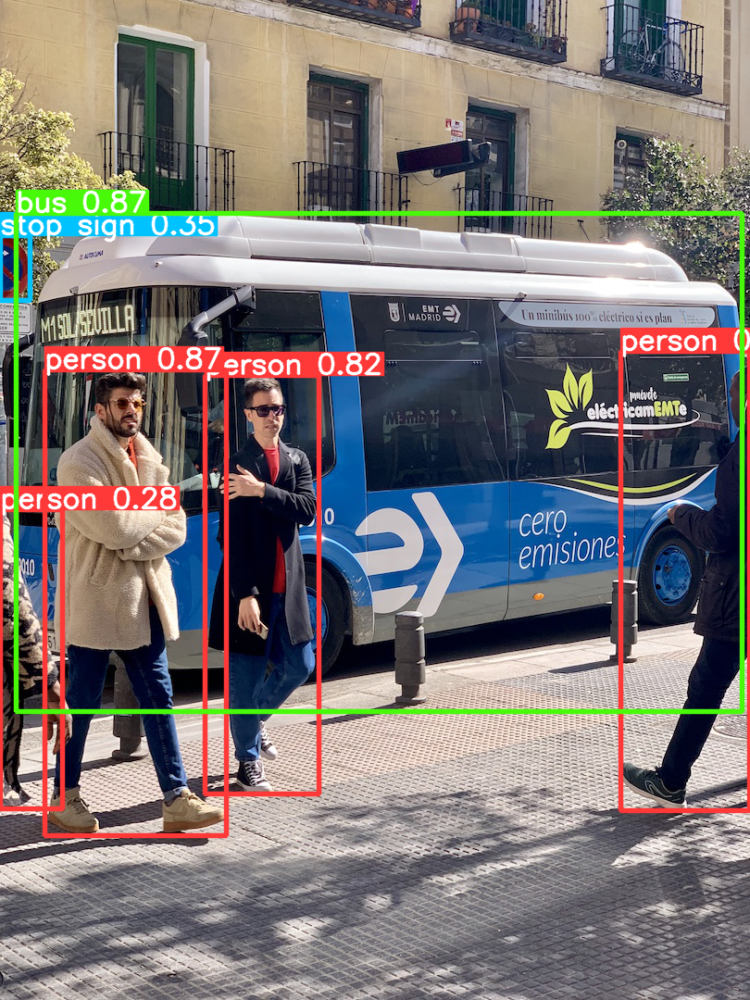

In [50]:
# Load a pretrained YOLO model (recommended for training)
model = YOLO('yolov8n.pt')

# Perform object detection on an image using the model
results = model('https://ultralytics.com/images/bus.jpg')
im_array = results[0].plot()  # plot a BGR numpy array of predictions
im = Image.fromarray(im_array[..., ::-1])  # RGB PIL image
im

In [24]:
results = model('./data/*.jpeg')


image 1/1 c:\Users\Yuchang\Documents\AIAP\assignments\assignment8\data\WhatsApp Image 2023-10-12 at 10.41.27.jpeg: 512x640 1 person, 1 bottle, 1 cup, 1 chair, 2 tvs, 1 laptop, 2 mouses, 1 keyboard, 152.0ms
Speed: 3.0ms preprocess, 152.0ms inference, 2.0ms postprocess per image at shape (1, 3, 512, 640)


In [31]:
print(model)

YOLO(
  (model): DetectionModel(
    (model): Sequential(
      (0): Conv(
        (conv): Conv2d(3, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
        (act): SiLU(inplace=True)
      )
      (1): Conv(
        (conv): Conv2d(16, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
        (act): SiLU(inplace=True)
      )
      (2): C2f(
        (cv1): Conv(
          (conv): Conv2d(32, 32, kernel_size=(1, 1), stride=(1, 1))
          (act): SiLU(inplace=True)
        )
        (cv2): Conv(
          (conv): Conv2d(48, 32, kernel_size=(1, 1), stride=(1, 1))
          (act): SiLU(inplace=True)
        )
        (m): ModuleList(
          (0): Bottleneck(
            (cv1): Conv(
              (conv): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (act): SiLU(inplace=True)
            )
            (cv2): Conv(
              (conv): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
              (act): SiLU(inplace=True)
   

In [26]:
i = 0
for r in results:
    # print(r.plot)
    print(i)
    i += 1

0


In [27]:
for r in results:
    im_array = r.plot()  # plot a BGR numpy array of predictions
    im = Image.fromarray(im_array[..., ::-1])  # RGB PIL image
    im.show()

In [34]:
download_from_url('https://raw.githubusercontent.com/obss/sahi/main/demo/demo_data/small-vehicles1.jpeg', 'demo_data/small-vehicles1.jpeg')
download_from_url('https://raw.githubusercontent.com/obss/sahi/main/demo/demo_data/terrain2.png', 'demo_data/terrain2.png')

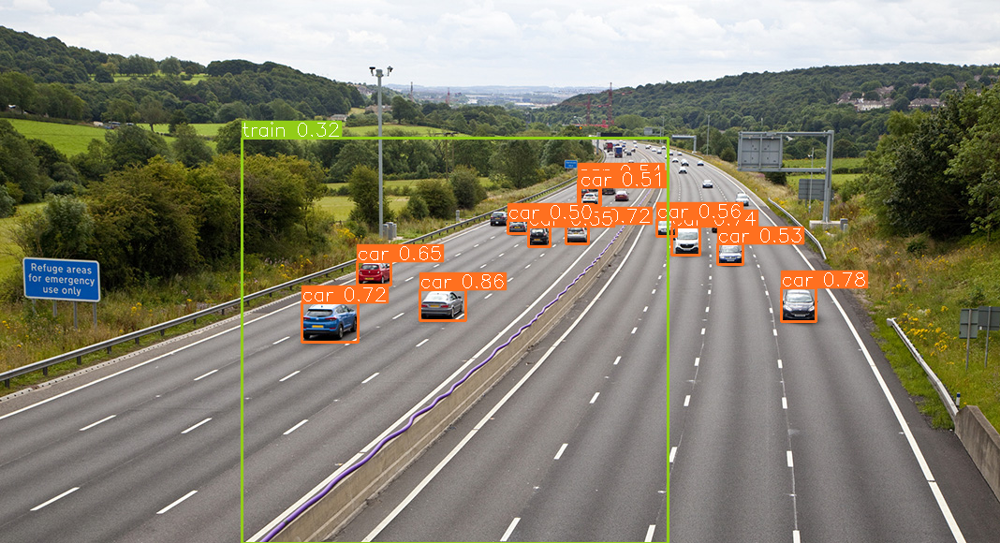

In [41]:
yolov8_model_path = "./yolov8n.pt"

detection_model = AutoDetectionModel.from_pretrained(
    model_type='yolov8',
    model_path=yolov8_model_path,
    confidence_threshold=0.3,
    device="cpu",  # or 'cuda:0'
)

# With an image path
result = get_prediction("demo_data/small-vehicles1.jpeg", detection_model)

result.export_visuals(export_dir="demo_data/")
ip_image("demo_data/prediction_visual.png")

Performing prediction on 15 number of slices.


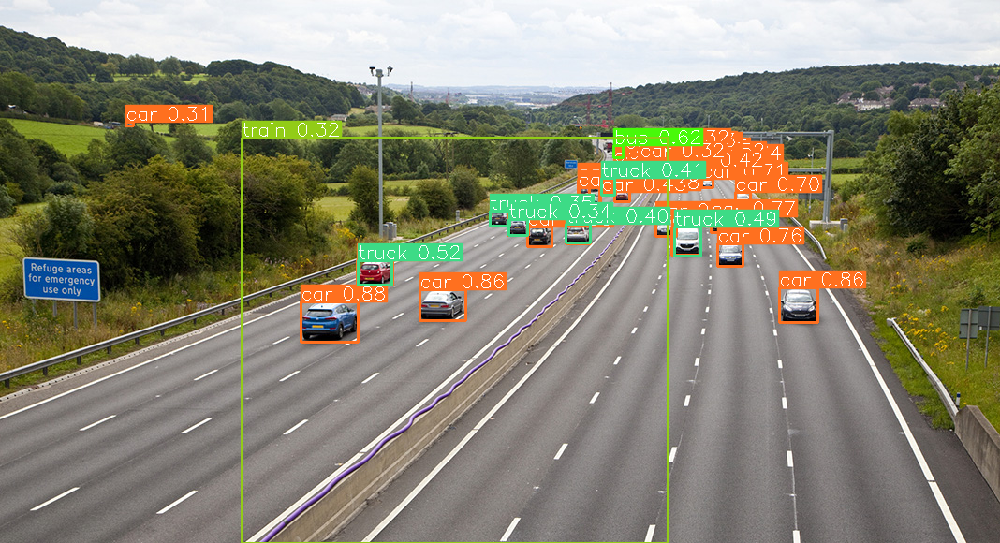

In [44]:
result = get_sliced_prediction(
    "demo_data/small-vehicles1.jpeg",
    detection_model,
    slice_height=256,
    slice_width=256,
    overlap_height_ratio=0.2,
    overlap_width_ratio=0.2
)

result.export_visuals(export_dir="demo_data2/")
ip_image("demo_data2/prediction_visual.png")

In [28]:
model2 = YOLO('yolov8n.pt')
# Train the model using the 'coco128.yaml' dataset for 3 epochs
history = model2.train(data='coco128.yaml', epochs=3)

New https://pypi.org/project/ultralytics/8.0.196 available  Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.195  Python-3.10.13 torch-2.0.1 CPU (Intel Core(TM) i7-9750H 2.60GHz)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=coco128.yaml, epochs=3, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=False, line_width=None, visualize=False, augment=False, agnostic_nms=Fa


Found https://ultralytics.com/images/bus.jpg locally at bus.jpg
image 1/1 c:\Users\Yuchang\Documents\AIAP\assignments\assignment8\bus.jpg: 640x480 4 persons, 1 bus, 1 stop sign, 201.2ms
Speed: 0.0ms preprocess, 201.2ms inference, 15.7ms postprocess per image at shape (1, 3, 640, 480)


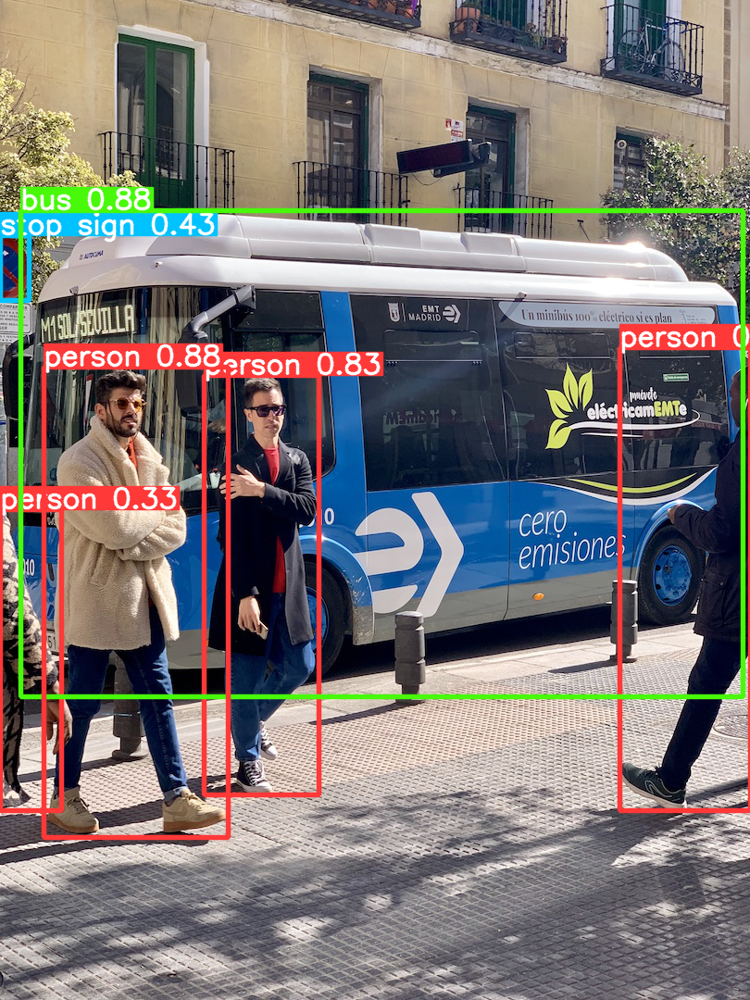

In [29]:
results = model2('https://ultralytics.com/images/bus.jpg')

im_array = results[0].plot()  # plot a BGR numpy array of predictions
im = Image.fromarray(im_array[..., ::-1])  # RGB PIL image
im

In [51]:
# Replace the label number of hello panda from 0 to 80 as 0-79 are used in coco data.
coco128_dir = pathlib.Path(os.path.join(".", "datasets", "coco128", "labels", "train2017")).with_suffix('')

cat = []
for ele in coco128_dir.glob("*.txt"):
    with open(ele, 'r') as f:
        for line in f:
            cat.append(line.split()[0])
cat_128 = pd.Series(cat)
print(cat_128.unique())
print(len(cat_128.unique()))
(cat_128 == '54').sum()

['45' '50' '49' '23' '58' '75' '22' '25' '0' '16' '17' '20' '2' '7' '11' '74' '6' '3' '1' '36' '4' '26' '43' '69' '68' '73' '42' '55' '13' '56' '53' '60' '41' '44' '59' '77' '72' '71' '39' '46' '48' '14' '33' '40' '27' '76' '34' '51' '31' '79' '57' '65' '9' '24' '5' '28' '29' '52' '67' '35' '32' '30' '64' '63' '8'
 '38' '54' '15' '21' '61' '62']
71


14

In [52]:
donut_file_dict = {}
for ele in coco128_dir.glob("*.txt"):
    with_donut = 0
    with open(ele, 'r') as f:
        for line in f:
            if line.split()[0] == "54":
               with_donut += 1
    if with_donut > 0:
       donut_file_dict[ele] = with_donut

In [53]:
donut_file_dict

{WindowsPath('datasets/coco128/labels/train2017/000000000436.txt'): 1,
 WindowsPath('datasets/coco128/labels/train2017/000000000438.txt'): 13}

In [4]:
# Replace the label number of hello panda from 0 to 80 as 0-79 are used in coco data.
train_label_dir = pathlib.Path(os.path.join(".", "train", "labels")).with_suffix('')

for ele in train_label_dir.glob("*.txt"):
    with open(ele, 'r') as f:
        aaa = f.read()
    with open(ele, 'w') as f:
        aaa = re.sub("\n0", "\n80", re.sub("^0", "80", aaa))
        f.write(aaa)

In [7]:
# Replace the label number of hello panda in valid and test directories from 0 to 80 as 0-79 are used in coco data.
train_label_dir = pathlib.Path(os.path.join(".", "train", "labels")).with_suffix('')

# for ele in os.listdir(train_label_dir):
for sub_dir in ["valid", "test"]:
    sub_dir_label = pathlib.Path(os.path.join(".", sub_dir, "labels")).with_suffix('')
    for ele in sub_dir_label.glob("*.txt"):
        with open(ele, 'r') as f:
            aaa = f.read()
        with open(ele, 'w') as f:
            aaa = re.sub("\n0", "\n80", re.sub("^0", "80", aaa))
            f.write(aaa)

In [2]:
model3 = YOLO('yolov8n.pt')

history = model3.train(data='my_coco128.yaml', epochs=1)


New https://pypi.org/project/ultralytics/8.0.197 available  Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.195  Python-3.10.13 torch-2.0.1 CPU (Intel Core(TM) i7-9750H 2.60GHz)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=my_coco128.yaml, epochs=1, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=False, line_width=None, visualize=False, augment=False, agnostic_nms


image 1/1 c:\Users\Yuchang\Documents\AIAP\assignments\assignment8\bus.jpg: 640x480 5 persons, 1 bus, 247.0ms
Speed: 3.0ms preprocess, 247.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 480)


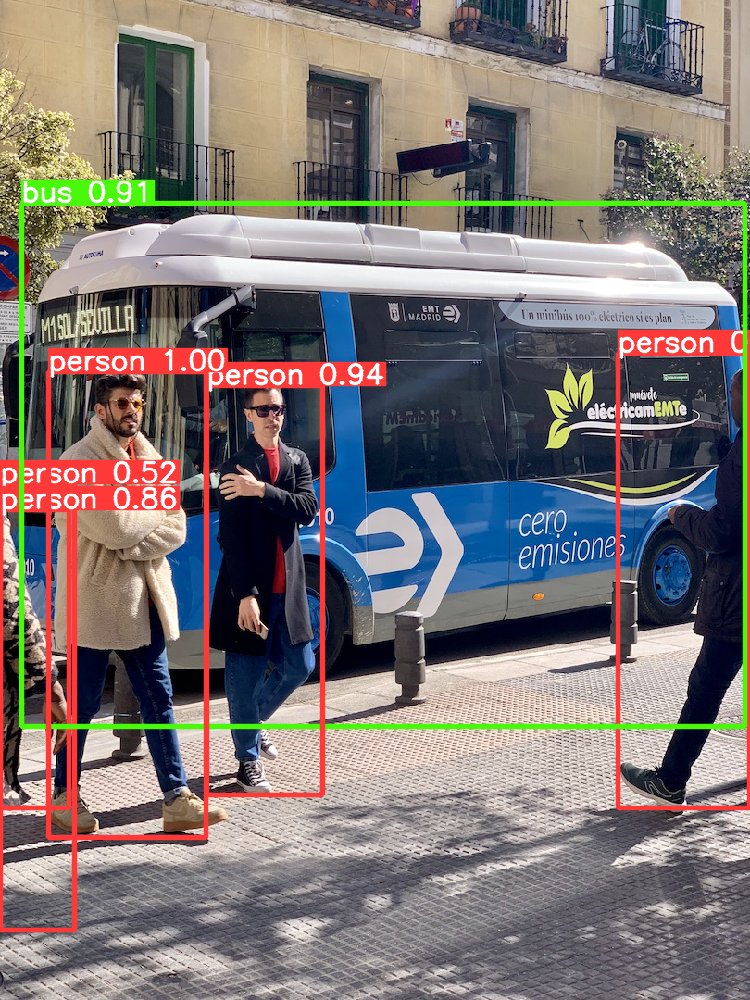

In [40]:
results = model4('./bus.jpg')

im_array = results[0].plot()  # plot a BGR numpy array of predictions
im = Image.fromarray(im_array[..., ::-1])  # RGB PIL image
im

In [37]:
model4 = YOLO('yolov8s.pt')
# Train the model using the 'coco128.yaml' dataset for 3 epochs
history4 = model4.train(data='combine_data.yaml', epochs=10, optimizer='AdamW', lr0=0.001, lrf=0.0002)

New https://pypi.org/project/ultralytics/8.0.197 available  Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.195  Python-3.10.13 torch-2.0.1 CPU (Intel Core(TM) i7-9750H 2.60GHz)
engine\trainer: task=detect, mode=train, model=yolov8s.pt, data=combine_data.yaml, epochs=10, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=False, line_width=None, visualize=False, augment=False, agnostic


image 1/1 c:\Users\Yuchang\Documents\AIAP\assignments\assignment8\data\IMG_2831.jpg: 640x480 4 hello pandas, 355.0ms
Speed: 3.0ms preprocess, 355.0ms inference, 22.0ms postprocess per image at shape (1, 3, 640, 480)


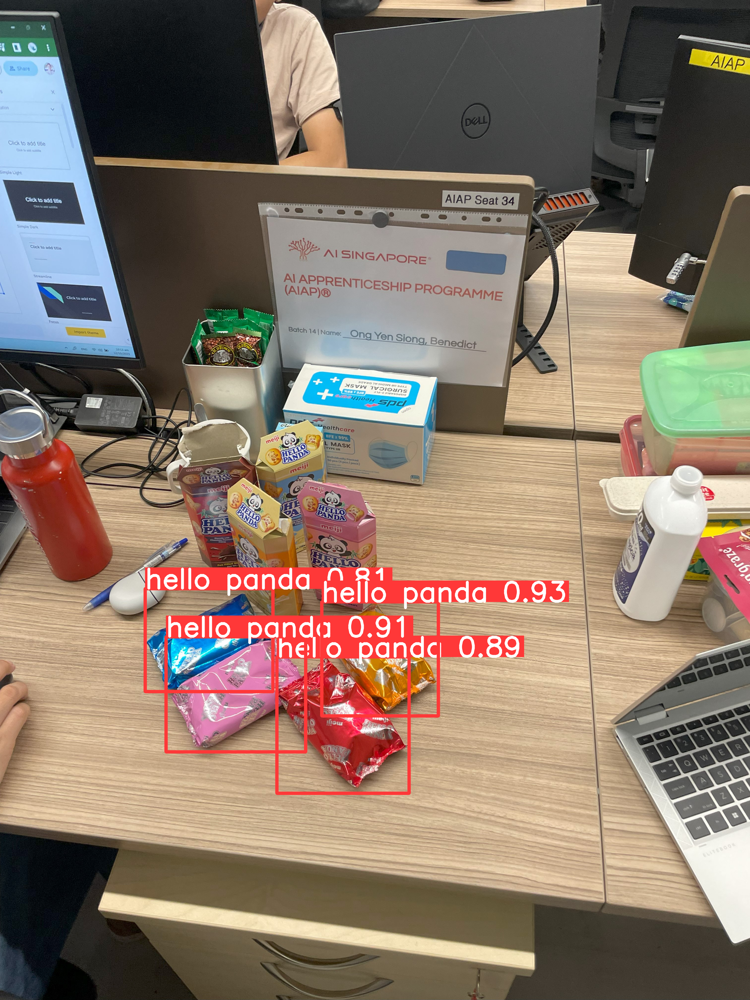

In [38]:
results = model4('./data/IMG_2831.jpg')

im_array = results[0].plot()  # plot a BGR numpy array of predictions
im = Image.fromarray(im_array[..., ::-1])  # RGB PIL image
im


image 1/1 c:\Users\Yuchang\Documents\AIAP\assignments\assignment8\datasets\test\images\IMG_2830_jpg.rf.171dde021e244a2d6c995fc4d2c8dd73.jpg: 640x640 5 hello pandas, 318.0ms
Speed: 4.0ms preprocess, 318.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


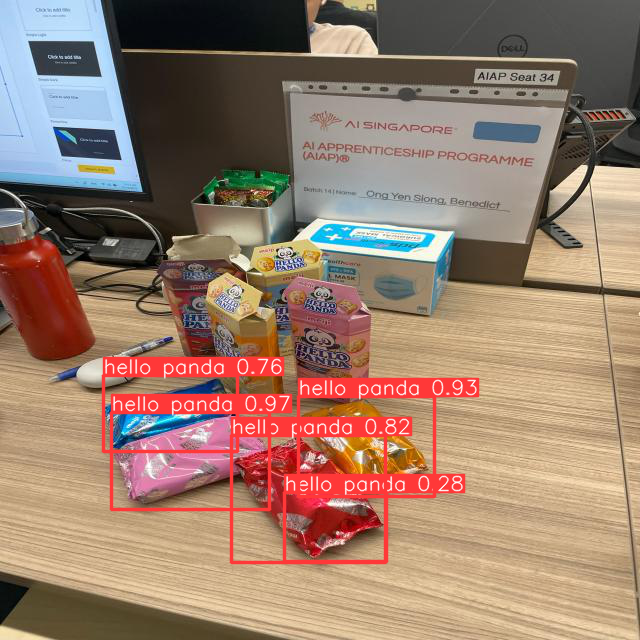

In [39]:
results = model4('./datasets/test/images/IMG_2830_jpg.rf.171dde021e244a2d6c995fc4d2c8dd73.jpg')

im_array = results[0].plot()  # plot a BGR numpy array of predictions
im = Image.fromarray(im_array[..., ::-1])  # RGB PIL image
im

In [2]:
coco_cat_list = ["person", "bicycle", "car", "motorcycle", "airplane", "bus", "train",
                "truck", "boat", "traffic light", "fire hydrant", "stop sign",
                "parking meter", "bench", "bird", "cat", "dog", "horse", "sheep", "cow",
                "elephant", "bear", "zebra", "giraffe", "backpack", "umbrella", "handbag",
                "tie", "suitcase", "frisbee", "skis", "snowboard", "sports ball", "kite",
                "baseball bat", "baseball glove", "skateboard", "surfboard",
                "tennis racket", "bottle", "wine glass", "cup", "fork", "knife", "spoon",
                "bowl", "banana", "apple", "sandwich", "orange", "broccoli", "carrot",
                "hot dog", "pizza", "donut", "cake", "chair", "couch", "potted plant",
                "bed", "dining table", "toilet", "tv", "laptop", "mouse", "remote",
                "keyboard", "cell phone", "microwave", "oven", "toaster", "sink",
                "refrigerator", "book", "clock", "vase", "scissors", "teddy bear",
                "hair drier", "toothbrush"]

manual_cat_list = ['Hello Panda', 'bottle', 'cell phone', 'chair', 'cup', 'keyboard', 
                   'laptop', 'mouse', 'person']

In [18]:
manual_cat_dict=dict(enumerate(manual_cat_list[1:], 1))
manual_cat_dict


{1: 'bottle',
 2: 'cell phone',
 3: 'chair',
 4: 'cup',
 5: 'keyboard',
 6: 'laptop',
 7: 'mouse',
 8: 'person'}

In [19]:
manual_coco_cat_dict = {k: {k:v for v, k in enumerate(coco_cat_list)}[v] for k, v in manual_cat_dict.items()}
manual_coco_cat_dict

{1: 39, 2: 67, 3: 56, 4: 41, 5: 66, 6: 63, 7: 64, 8: 0}

In [20]:
for k, v in manual_coco_cat_dict.items():
    # print(type(k), type(v))
    print("^"+str(k)+" ", str(v)+" ")

^1  39 
^2  67 
^3  56 
^4  41 
^5  66 
^6  63 
^7  64 
^8  0 


In [21]:
with open("./data/train/labels/IMG_8631_jpeg.rf.ff7d99c79c4d17d73193ca043273258d.txt") as f:
    aaa = f.read()
aaa

'0 0.7375 0.828125 0.11953125 0.115625\n0 0.64765625 0.77421875 0.07578125 0.13359375\n0 0.609375 0.76875 0.071875 0.1203125\n0 0.571875 0.7734375 0.07265625 0.115625\n6 0.6765625 0.65703125 0.3046875 0.28203125\n6 0.815625 0.57890625 0.14140625 0.15859375\n6 0.96484375 0.51640625 0.0703125 0.09375\n7 0.78359375 0.67265625 0.06640625 0.0375\n7 0.93359375 0.61640625 0.0546875 0.0328125\n5 0.90859375 0.63984375 0.1046875 0.05859375\n5 0.95703125 0.55703125 0.05390625 0.0484375\n1 0.63359375 0.571875 0.03984375 0.16953125\n1 0.91875 0.55 0.0421875 0.12109375\n1 0.85625 0.52421875 0.03125 0.09140625\n1 0.83046875 0.45390625 0.0328125 0.15234375\n1 0.89921875 0.465625 0.04765625 0.109375\n1 0.7953125 0.44609375 0.03671875 0.128125\n1 0.03671875 0.55390625 0.06953125 0.4953125'

In [13]:
for sub_dir in ["train", "valid", "test"]:
    sub_dir_label = pathlib.Path(os.path.join(".", "data", sub_dir, "labels")).with_suffix('')
    for ele in sub_dir_label.glob("*.txt"):
        with open(ele, 'r') as f:
            aaa = f.read()
        with open(ele, 'w') as f:
            aaa = re.sub("\n0 ", "\n80 ", re.sub("^0 ", "80 ", aaa))
            for k, v in manual_coco_cat_dict.items():
                aaa = re.sub("\n"+str(k)+" ", "\n"+str(v)+" ", re.sub("^"+str(k)+" ", str(v)+" ", aaa))
            f.write(aaa)

In [21]:
model5 = YOLO('yolov8s.pt')
# Train the model using the 'coco128.yaml' dataset for 3 epochs
history5 = model5.train(data='combine_data2.yaml', epochs=1, optimizer='AdamW', lr0=0.001, lrf=0.0002)

Ultralytics YOLOv8.0.199  Python-3.10.13 torch-2.0.1 CPU (Intel Core(TM) i7-9750H 2.60GHz)
engine\trainer: task=detect, mode=train, model=yolov8s.pt, data=combine_data2.yaml, epochs=1, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train9, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=False, line_width=None, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, keras=False, optimize


image 1/1 c:\Users\Yuchang\Documents\AIAP\assignments\assignment8\data\IMG_2831.jpg: 640x480 5 persons, 3 bottles, 3 laptops, 4 hello pandas, 310.0ms
Speed: 19.0ms preprocess, 310.0ms inference, 30.8ms postprocess per image at shape (1, 3, 640, 480)


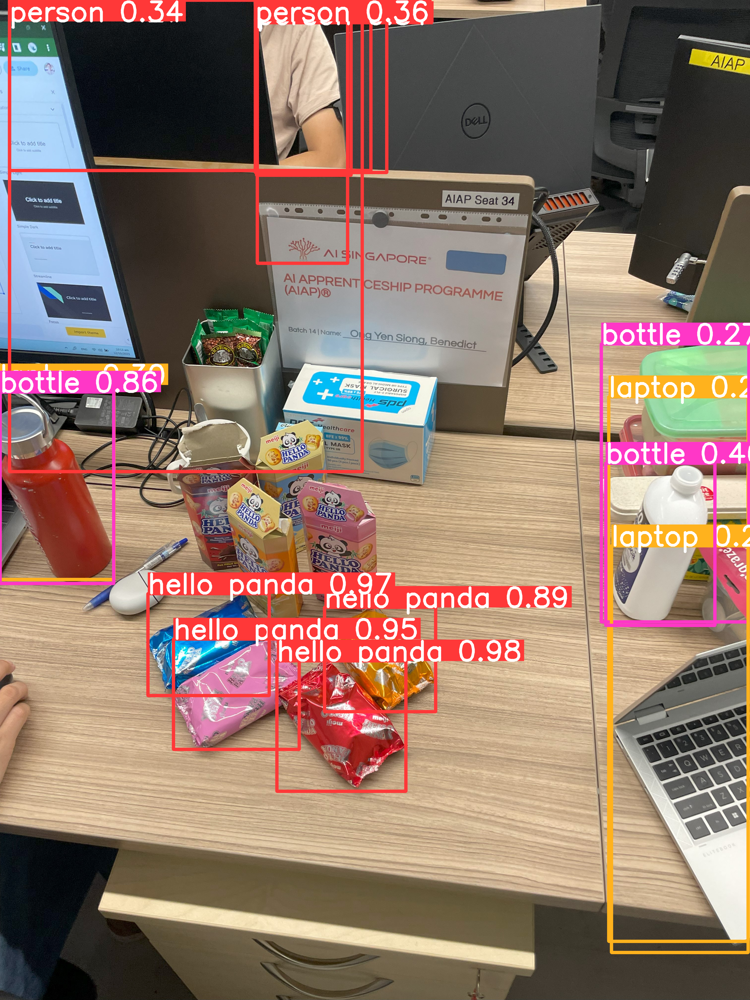

In [3]:
results = model5('./data/IMG_2831.jpg')

im_array = results[0].plot()  # plot a BGR numpy array of predictions
im = Image.fromarray(im_array[..., ::-1])  # RGB PIL image
im


image 1/1 c:\Users\Yuchang\Documents\AIAP\assignments\assignment8\datasets\test\images\IMG_2830_jpg.rf.171dde021e244a2d6c995fc4d2c8dd73.jpg: 640x640 1 person, 1 laptop, 4 hello pandas, 363.0ms
Speed: 4.0ms preprocess, 363.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)


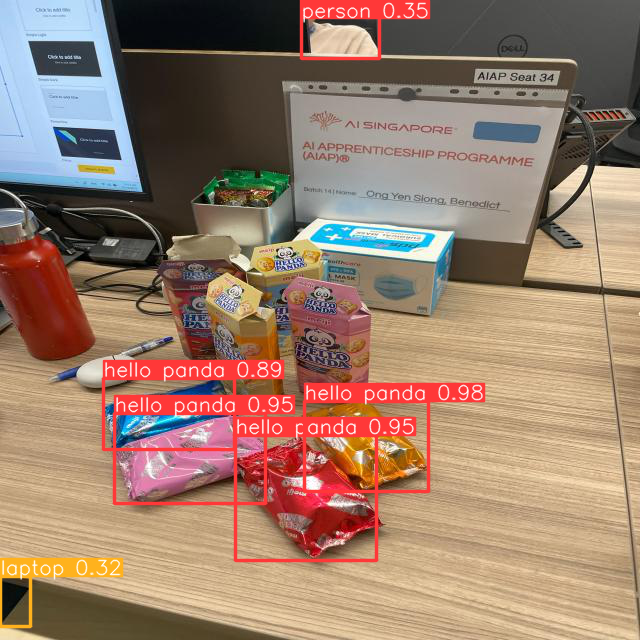

In [4]:
results = model5('./datasets/test/images/IMG_2830_jpg.rf.171dde021e244a2d6c995fc4d2c8dd73.jpg')

im_array = results[0].plot()  # plot a BGR numpy array of predictions
im = Image.fromarray(im_array[..., ::-1])  # RGB PIL image
im

In [27]:
import torch

if 80 in (results[0].boxes.data[:,5]).type(torch.int):
    print("yes")

yes


In [21]:
(results[0].boxes.data[:,5] == 80).sum().item()

4

In [ ]:
import smtplib, ssl

port = 465  # For SSL
smtp_server = "smtp.gmail.com"
sender_email = "my@gmail.com"  # Enter your address
receiver_email = "your@gmail.com"  # Enter receiver address
password = input("Type your password and press enter: ")
message = """\
Subject: Hi there

This message is sent from Python."""

context = ssl.create_default_context()
with smtplib.SMTP_SSL(smtp_server, port, context=context) as server:
    server.login(sender_email, password)
    server.sendmail(sender_email, receiver_email, message)

In [5]:
import base64
from email.mime.text import MIMEText
from google_auth_oauthlib.flow import InstalledAppFlow
from googleapiclient.discovery import build
from requests import HTTPError

SCOPES = [
        "https://www.googleapis.com/auth/gmail.send"
    ]
flow = InstalledAppFlow.from_client_secrets_file('client_secret_582623130172-2me6idpsilft9pogjhtbctihbnie95gr.apps.googleusercontent.com.json', SCOPES)
creds = flow.run_local_server(port=0)

service = build('gmail', 'v1', credentials=creds)
message = MIMEText('As you can see, there are less than 2 Hello Panda in the pantry. Please top up. Thank you.')
message['to'] = 'yongdeng_xiao@aiap.sg'
message['subject'] = 'Please top up Hello Panda'
create_message = {'raw': base64.urlsafe_b64encode(message.as_bytes()).decode()}

try:
    message = (service.users().messages().send(userId="me", body=create_message).execute())
    print(F'sent message to {message} Message Id: {message["id"]}')
except HTTPError as error:
    print(F'An error occurred: {error}')
    message = None

Please visit this URL to authorize this application: https://accounts.google.com/o/oauth2/auth?response_type=code&client_id=582623130172-2me6idpsilft9pogjhtbctihbnie95gr.apps.googleusercontent.com&redirect_uri=http%3A%2F%2Flocalhost%3A49946%2F&scope=https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fgmail.send&state=oWES8HbH0pbH5IdehtMPkpiZgfdwce&access_type=offline
sent message to {'id': '18b370400b22e961', 'threadId': '18b370400b22e961', 'labelIds': ['SENT']} Message Id: 18b370400b22e961


In [13]:
import os
import smtplib
from email.mime.text import MIMEText

subject = "Please top up Hello Panda 2"
body = "As you can see, there are less than 2 Hello Panda in the pantry. Please top up. Thank you."
sender = "hellopanda351@gmail.com"
recipients = ["yongdeng_xiao@aiap.sg", "benedict_ong_ys@aiap.sg"]
password = "fcbd ijjc ahtp cmeq"


def send_email(subject, body, sender, recipients, password):
    msg = MIMEText(body)
    msg['Subject'] = subject
    msg['From'] = sender
    msg['To'] = ', '.join(recipients)
    with smtplib.SMTP_SSL('smtp.gmail.com', 465) as smtp_server:
       smtp_server.login(sender, password)
       smtp_server.sendmail(sender, recipients, msg.as_string())
    print("Message sent!")


send_email(subject, body, sender, recipients, password)

Message sent!


In [26]:
with open('./datasets/test/images/IMG_2830_jpg.rf.171dde021e244a2d6c995fc4d2c8dd73.jpg', 'rb') as f:
    image_test = f.read()

image_test

b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00\x00\x01\x00\x01\x00\x00\xff\xdb\x00C\x00\x08\x06\x06\x07\x06\x05\x08\x07\x07\x07\t\t\x08\n\x0c\x14\r\x0c\x0b\x0b\x0c\x19\x12\x13\x0f\x14\x1d\x1a\x1f\x1e\x1d\x1a\x1c\x1c $.\' ",#\x1c\x1c(7),01444\x1f\'9=82<.342\xff\xdb\x00C\x01\t\t\t\x0c\x0b\x0c\x18\r\r\x182!\x1c!22222222222222222222222222222222222222222222222222\xff\xc0\x00\x11\x08\x02\x80\x02\x80\x03\x01"\x00\x02\x11\x01\x03\x11\x01\xff\xc4\x00\x1f\x00\x00\x01\x05\x01\x01\x01\x01\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x01\x02\x03\x04\x05\x06\x07\x08\t\n\x0b\xff\xc4\x00\xb5\x10\x00\x02\x01\x03\x03\x02\x04\x03\x05\x05\x04\x04\x00\x00\x01}\x01\x02\x03\x00\x04\x11\x05\x12!1A\x06\x13Qa\x07"q\x142\x81\x91\xa1\x08#B\xb1\xc1\x15R\xd1\xf0$3br\x82\t\n\x16\x17\x18\x19\x1a%&\'()*456789:CDEFGHIJSTUVWXYZcdefghijstuvwxyz\x83\x84\x85\x86\x87\x88\x89\x8a\x92\x93\x94\x95\x96\x97\x98\x99\x9a\xa2\xa3\xa4\xa5\xa6\xa7\xa8\xa9\xaa\xb2\xb3\xb4\xb5\xb6\xb7\xb8\xb9\xba\xc2\xc3\xc4\xc5\xc6\xc7\xc8\xc9\xca\xd2\xd3\

In [28]:
from email.mime.multipart import MIMEMultipart
from email.mime.image import MIMEImage
from io import BytesIO

results = model5('./datasets/test/images/IMG_2830_jpg.rf.171dde021e244a2d6c995fc4d2c8dd73.jpg')

im_array = results[0].plot()  # plot a BGR numpy array of predictions
im = Image.fromarray(im_array[..., ::-1])  # RGB PIL image

subject = "Please top up Hello Panda 2"
body = "As you can see, there are less than 2 Hello Panda in the pantry. Please top up. Thank you."
sender = "hellopanda351@gmail.com"
recipients = ["yongdeng_xiao@aiap.sg", "benedict_ong_ys@aiap.sg"]
password = "fcbd ijjc ahtp cmeq"

def send_email(subject, body, image, sender, recipients, password):
    msg = MIMEText(body)
    msg['Subject'] = subject
    msg['From'] = sender
    msg['To'] = ', '.join(recipients)
    msg.attach(MIMEImage(BytesIO(image)))
    with smtplib.SMTP_SSL('smtp.gmail.com', 465) as smtp_server:
       smtp_server.login(sender, password)
       smtp_server.sendmail(sender, recipients, msg.as_string())
    print("Message sent!")


send_email(subject, body, im, sender, recipients, password)


image 1/1 c:\Users\Yuchang\Documents\AIAP\assignments\assignment8\datasets\test\images\IMG_2830_jpg.rf.171dde021e244a2d6c995fc4d2c8dd73.jpg: 640x640 3 dogs, 2 laptops, 18 hello pandas, 394.0ms
Speed: 2.0ms preprocess, 394.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)


ValueError: ndarray is not C-contiguous